In [1]:
import sys
import os
# Agrega la raíz del proyecto al path
project_root = os.path.abspath(os.path.join(os.getcwd(), ".."))
if project_root not in sys.path:
    sys.path.insert(0, project_root)

In [2]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image

# Cargue de módulos de preprocesamiento

# 1) Funciones de preprocesamiento ya definidas: recortar_tanque, eliminar_timestamp, balance_blancos, 
#    ajustar_brillo_contraste, segmentar_peces_por_color.
from scripts.prep_deteccion_ROI import recortar_tanque, recortar_tanque_con_desplazamiento_superior
from scripts.prep_remover_timestamp import eliminar_timestamp_manualmente
from scripts.prep_remover_timestamp import eliminar_timestamp_por_color
from scripts.prep_correcion_img import ajustar_brillo_contraste, balance_blancos_simple
from scripts.prep_segmentacion_peces import segmentar_peces_por_color, segmentar_peces_color_gris_naranja
from scripts.prep_mostrar_resultado import mostrar_preprocesadas_por_clase

### Preprocesamiento paso a paso con n imagenes

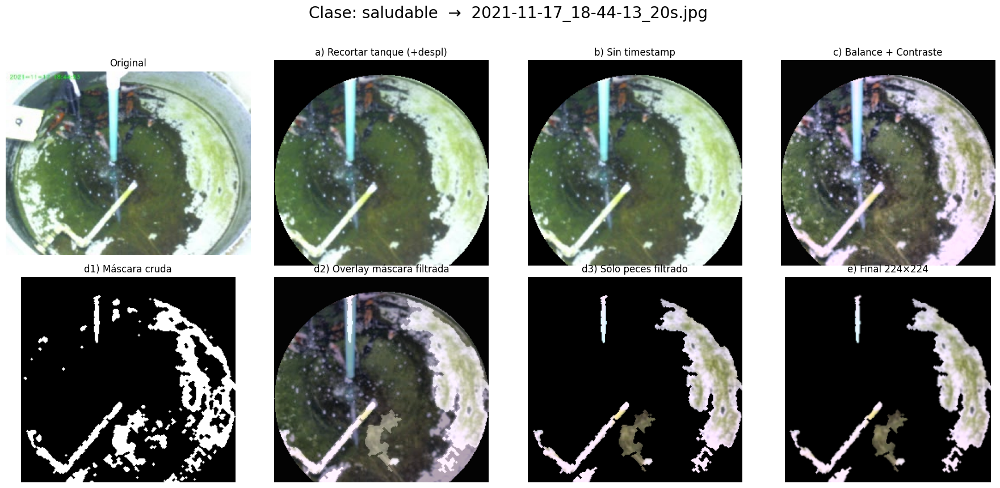

>>> Rangos HSV peces: H 0 - 179 | S 0 - 114 | V 3 - 255
>>> Rangos LAB peces: L 2 - 248 | a 115 - 144 | b 113 - 169

--------------------------------------------------------------------------------



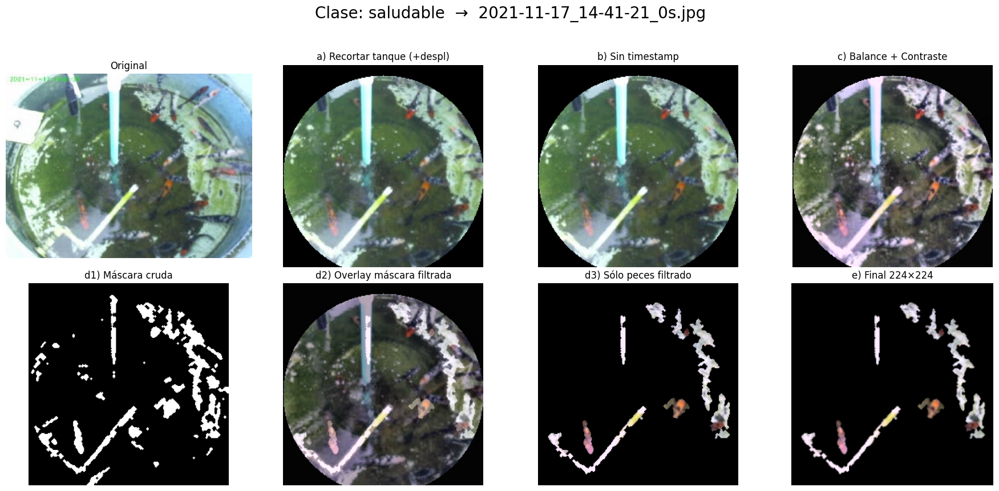

>>> Rangos HSV peces: H 0 - 179 | S 0 - 192 | V 56 - 255
>>> Rangos LAB peces: L 41 - 250 | a 115 - 172 | b 111 - 190

--------------------------------------------------------------------------------



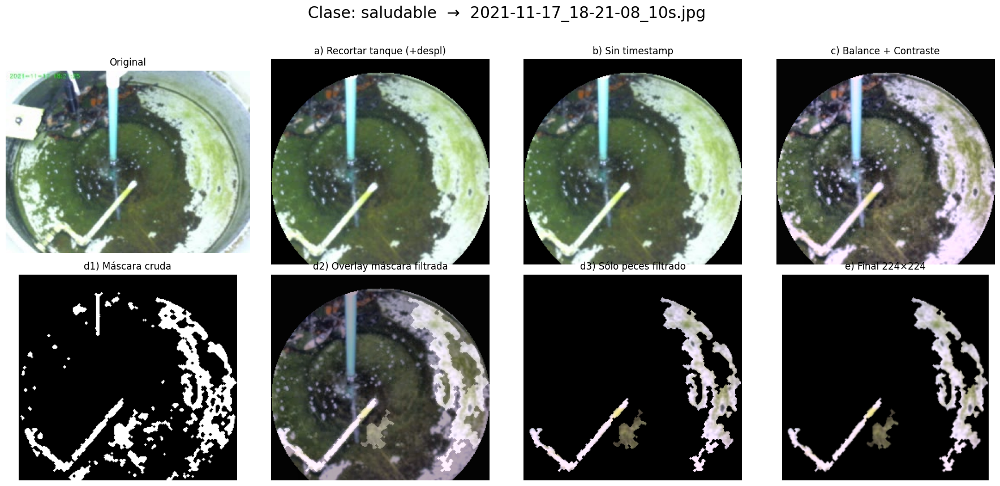

>>> Rangos HSV peces: H 0 - 179 | S 0 - 109 | V 3 - 255
>>> Rangos LAB peces: L 2 - 248 | a 114 - 144 | b 112 - 174

--------------------------------------------------------------------------------



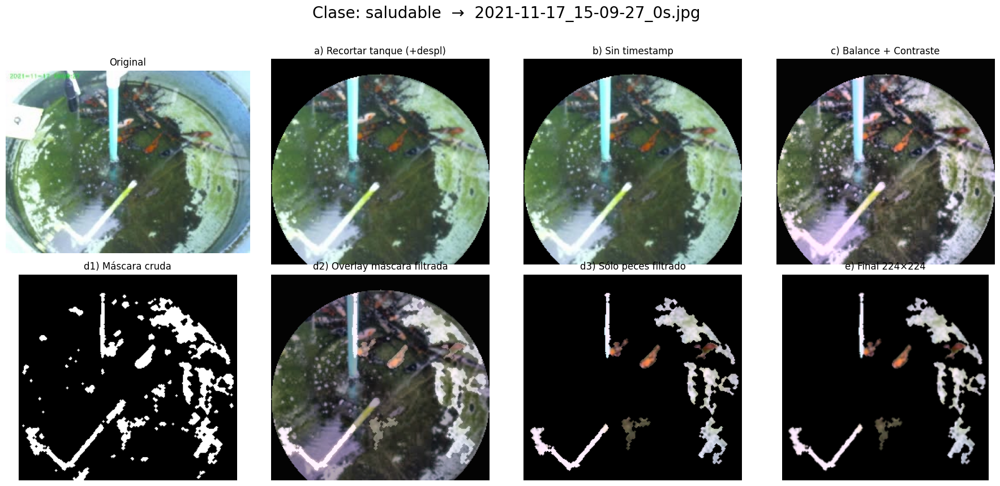

>>> Rangos HSV peces: H 0 - 179 | S 0 - 223 | V 49 - 255
>>> Rangos LAB peces: L 40 - 248 | a 118 - 171 | b 113 - 182

--------------------------------------------------------------------------------



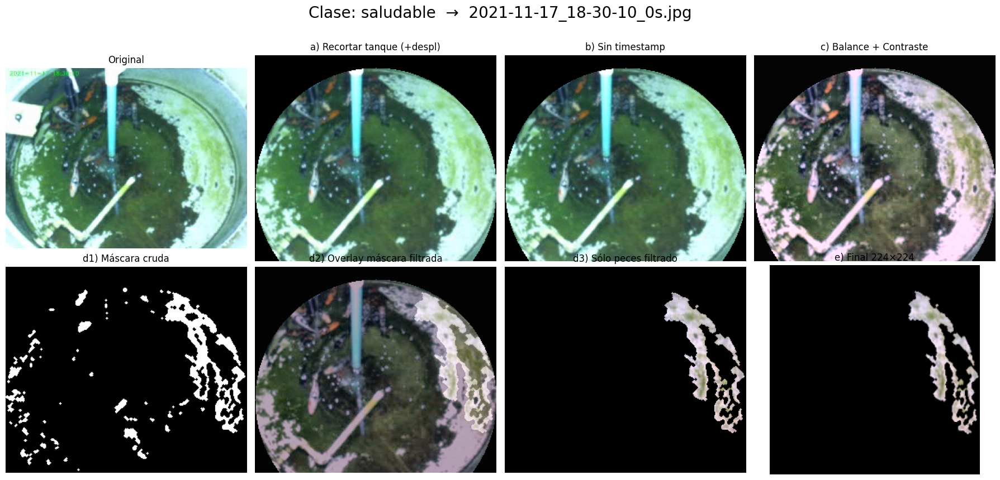

>>> Rangos HSV peces: H 0 - 179 | S 0 - 101 | V 116 - 255
>>> Rangos LAB peces: L 121 - 240 | a 112 - 141 | b 112 - 156

--------------------------------------------------------------------------------



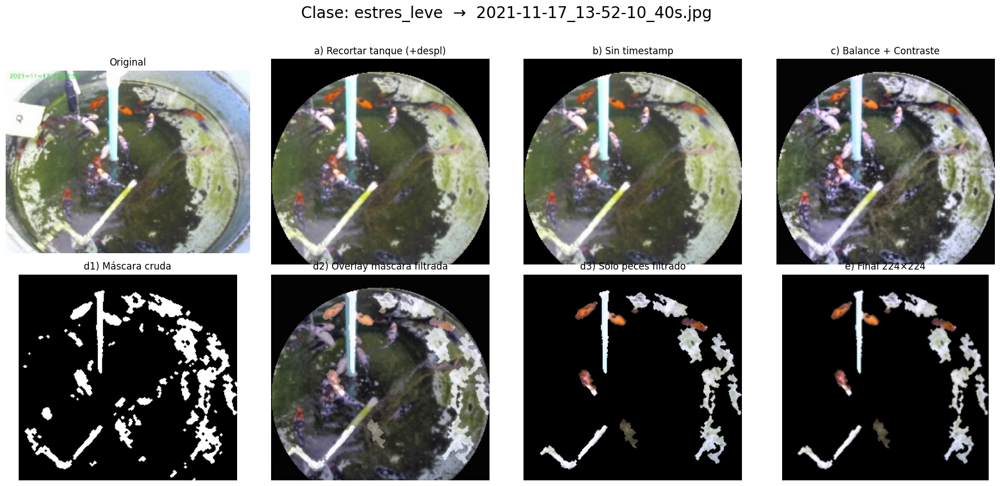

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 4 - 255
>>> Rangos LAB peces: L 2 - 253 | a 118 - 181 | b 113 - 195

--------------------------------------------------------------------------------



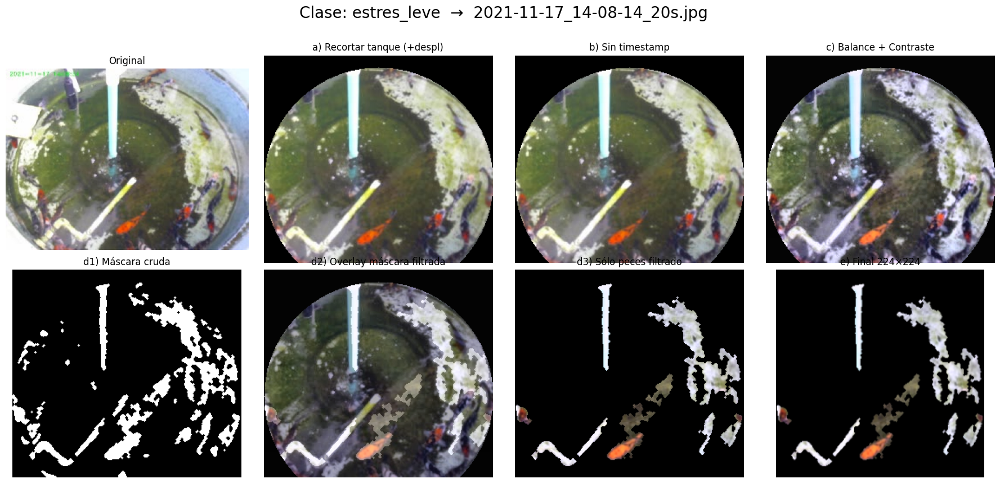

>>> Rangos HSV peces: H 0 - 179 | S 0 - 211 | V 3 - 255
>>> Rangos LAB peces: L 2 - 252 | a 118 - 184 | b 112 - 189

--------------------------------------------------------------------------------



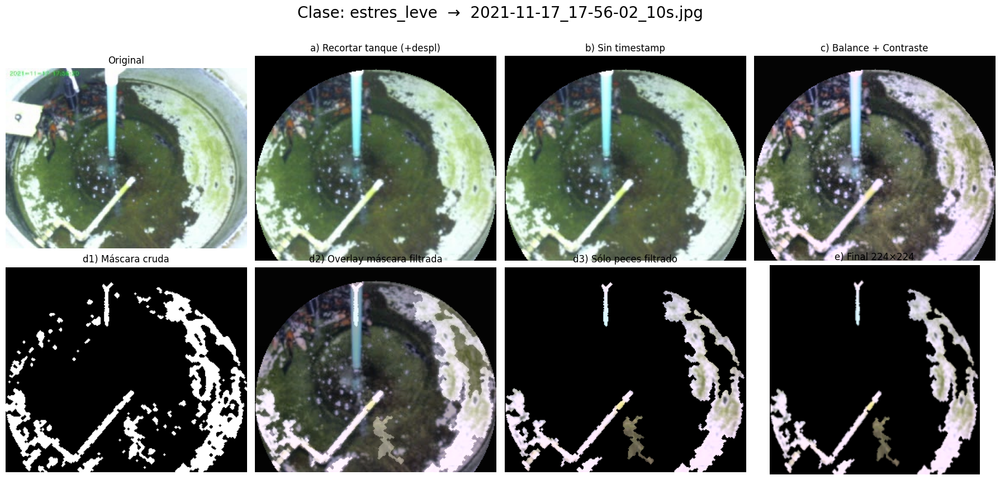

>>> Rangos HSV peces: H 0 - 179 | S 0 - 106 | V 3 - 255
>>> Rangos LAB peces: L 2 - 249 | a 117 - 143 | b 111 - 173

--------------------------------------------------------------------------------



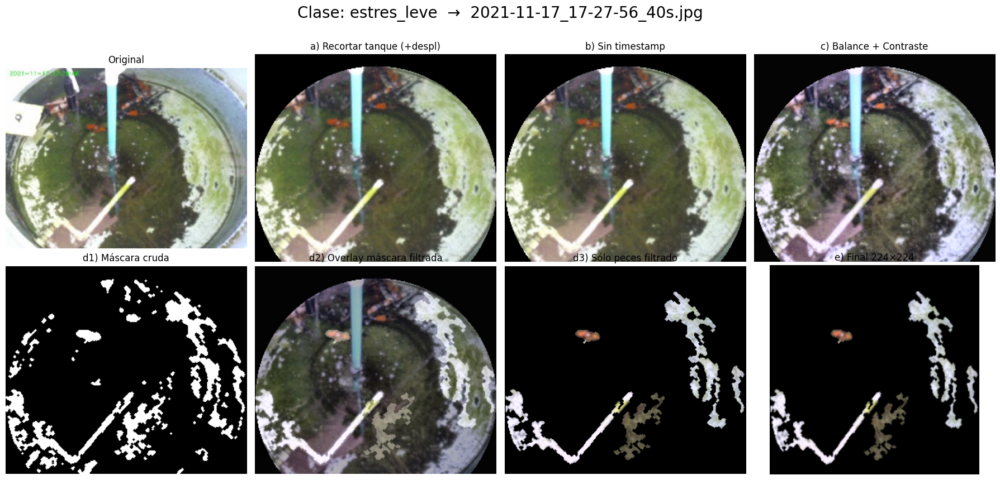

>>> Rangos HSV peces: H 0 - 179 | S 0 - 166 | V 3 - 255
>>> Rangos LAB peces: L 2 - 251 | a 112 - 170 | b 111 - 180

--------------------------------------------------------------------------------



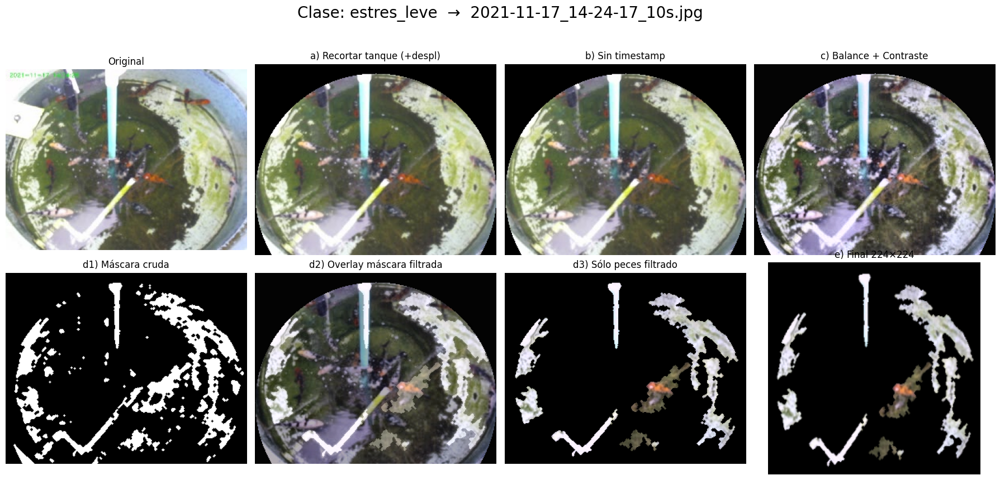

>>> Rangos HSV peces: H 0 - 179 | S 0 - 184 | V 47 - 255
>>> Rangos LAB peces: L 45 - 254 | a 117 - 164 | b 113 - 179

--------------------------------------------------------------------------------



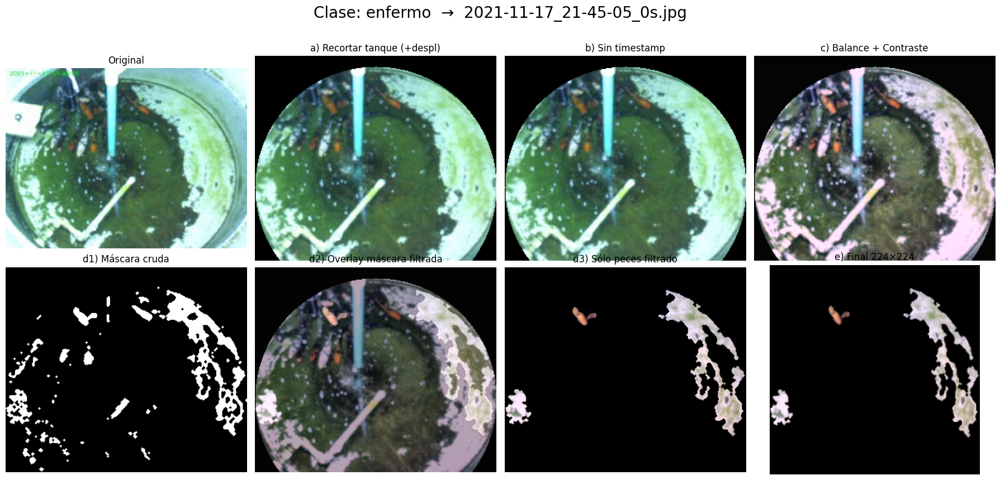

>>> Rangos HSV peces: H 0 - 179 | S 0 - 155 | V 3 - 255
>>> Rangos LAB peces: L 2 - 245 | a 113 - 163 | b 115 - 171

--------------------------------------------------------------------------------



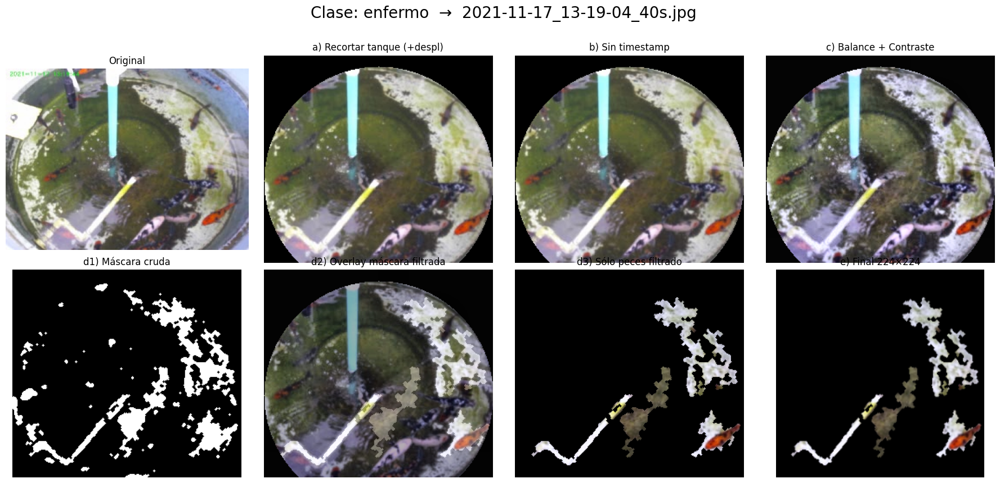

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 47 - 255
>>> Rangos LAB peces: L 19 - 254 | a 110 - 186 | b 112 - 195

--------------------------------------------------------------------------------



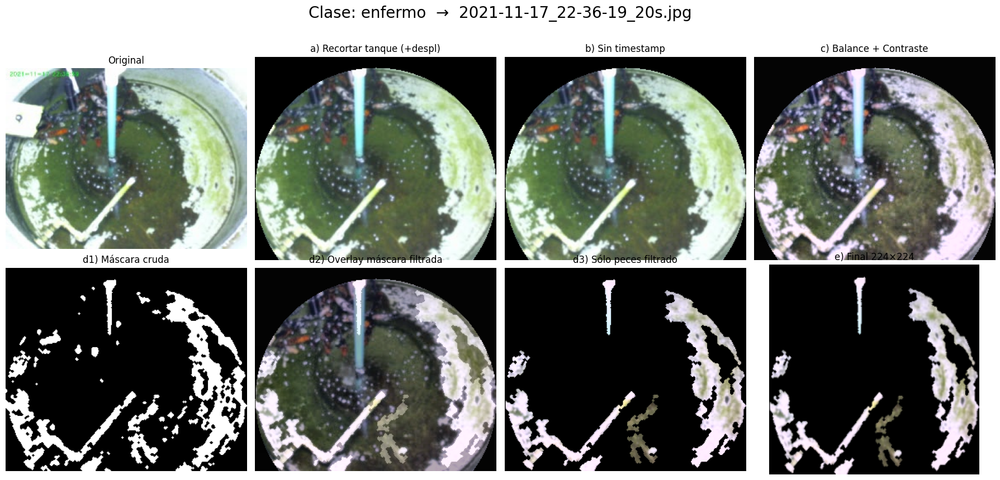

>>> Rangos HSV peces: H 0 - 179 | S 0 - 99 | V 3 - 255
>>> Rangos LAB peces: L 2 - 250 | a 113 - 143 | b 112 - 170

--------------------------------------------------------------------------------



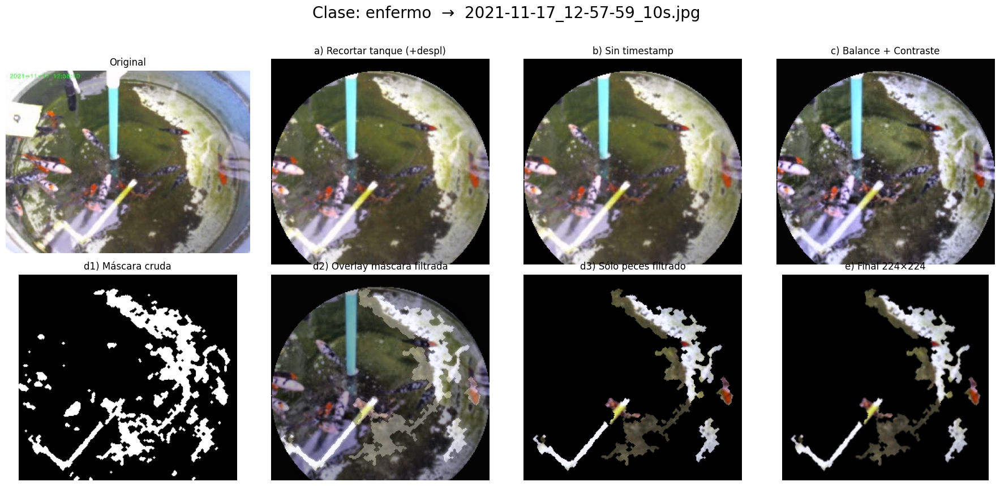

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 47 - 255
>>> Rangos LAB peces: L 32 - 254 | a 106 - 179 | b 112 - 194

--------------------------------------------------------------------------------



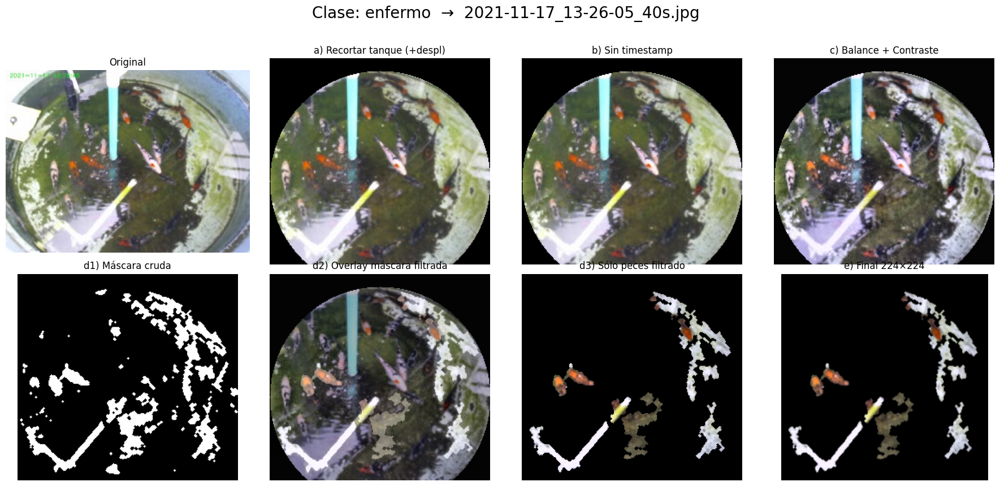

>>> Rangos HSV peces: H 0 - 179 | S 0 - 255 | V 49 - 255
>>> Rangos LAB peces: L 37 - 252 | a 108 - 174 | b 112 - 197

--------------------------------------------------------------------------------



In [3]:
# 1) Configurar rutas y parámetros
labels_csv        = "../data/labels_etiquetado_v2.csv"
image_dir         = "../data/images"
output_root       = "../data/dataset_procesado"
df                = pd.read_csv(labels_csv)

classes           = ["saludable", "estres_leve", "enfermo"]
samples_per_class = 5   # Mostrar 5 imágenes por clase para depuración

# Tomar muestra aleatoria de 5 imágenes por clase
muestras_por_clase = {}
for cls in classes:
    df_cls = df[df["etiqueta_rel"] == cls]
    if len(df_cls) >= samples_per_class:
        muestras_por_clase[cls] = df_cls.sample(samples_per_class, random_state=42)["imagen"].tolist()
    else:
        muestras_por_clase[cls] = df_cls["imagen"].tolist()
        print(f"Advertencia: Sólo {len(df_cls)} imágenes para '{cls}'.")

# 2) Rangos HSV para naranjas/rojizos
lower1   = np.array([0, 60, 60])
upper1   = np.array([30, 255, 255])
lower2   = np.array([150, 60, 60])
upper2   = np.array([180, 255, 255])

# 3) Parámetros para LAB y filtrado por área mínima
umbral_L = 180
delta_ab = 10
area_min = 200  # Área mínima en píxeles para considerar “pez” válido

# 4) Mostrar paso a paso para cada imagen seleccionada
for cls in classes:
    imgs = muestras_por_clase[cls]
    for img_name in imgs:
        img_path = os.path.join(image_dir, img_name)
        img_original = cv2.imread(img_path)
        if img_original is None:
            continue

        # a) Recortar tanque (+ desplazamiento superior)
        roi = recortar_tanque_con_desplazamiento_superior(img_original, desplazar_arriba=50)

        # b) Eliminar timestamp
        sin_ts = eliminar_timestamp_manualmente(roi)

        # c) Balance de blancos + Contraste
        wb = balance_blancos_simple(sin_ts)
        eq = ajustar_brillo_contraste(wb)

        # d) Segmentar peces (naranja + gris) → máscara “cruda”
        mask_clean, seg_crudo, hsv, lab = segmentar_peces_color_gris_naranja(
            eq,
            bounds_color1=(lower1, upper1),
            bounds_color2=(lower2, upper2),
            umbral_L=umbral_L,
            delta_ab=delta_ab
        )

        # e) Filtrar contornos por área mínima (para desechar motas de ruido)
        contours, _ = cv2.findContours(mask_clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        mask_filtered = np.zeros_like(mask_clean)
        for cnt in contours:
            if cv2.contourArea(cnt) >= area_min:
                cv2.drawContours(mask_filtered, [cnt], -1, 255, -1)

        # f) Generar imagen “solo peces” aplicando la máscara filtrada
        seg_filtrado = cv2.bitwise_and(eq, eq, mask=mask_filtered)

        # g) Overlay de la máscara filtrada sobre la imagen corregida
        mask_col   = cv2.cvtColor(mask_filtered, cv2.COLOR_GRAY2BGR)
        overlay    = cv2.addWeighted(eq, 0.7, mask_col, 0.3, 0)

        # h) Redimensionar resultado final a 224×224
        img_resized = cv2.resize(seg_filtrado, (224, 224), interpolation=cv2.INTER_AREA)

        # ─── 5) Visualizar los pasos en 2×4 ────────────────────────────────
        fig, axes = plt.subplots(2, 4, figsize=(18, 9))
        fig.suptitle(f"Clase: {cls}  →  {img_name}", fontsize=20)

        # (1) Imagen original
        ax = axes[0, 0]
        ax.imshow(cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB))
        ax.set_title("Original")
        ax.axis("off")

        # (2) Recorte del tanque (+ desplazamiento superior)
        ax = axes[0, 1]
        ax.imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
        ax.set_title("a) Recortar tanque (+despl)")
        ax.axis("off")

        # (3) Sin timestamp
        ax = axes[0, 2]
        ax.imshow(cv2.cvtColor(sin_ts, cv2.COLOR_BGR2RGB))
        ax.set_title("b) Sin timestamp")
        ax.axis("off")

        # (4) Balance + Contraste
        ax = axes[0, 3]
        ax.imshow(cv2.cvtColor(eq, cv2.COLOR_BGR2RGB))
        ax.set_title("c) Balance + Contraste")
        ax.axis("off")

        # (5) Máscara “cruda” (antes del filtrado por área)
        ax = axes[1, 0]
        ax.imshow(mask_clean, cmap="gray")
        ax.set_title("d1) Máscara cruda")
        ax.axis("off")

        # (6) Overlay de máscara filtrada sobre la imagen corregida
        ax = axes[1, 1]
        ax.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
        ax.set_title("d2) Overlay máscara filtrada")
        ax.axis("off")

        # (7) Solo peces (máscara filtrada aplicada)
        ax = axes[1, 2]
        ax.imshow(cv2.cvtColor(seg_filtrado, cv2.COLOR_BGR2RGB))
        ax.set_title("d3) Sólo peces filtrado")
        ax.axis("off")

        # (8) Final 224×224
        ax = axes[1, 3]
        ax.imshow(cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB))
        ax.set_title("e) Final 224×224")
        ax.axis("off")

        plt.tight_layout(rect=[0, 0.03, 1, 0.95])
        plt.show()

        # ─── 6) Imprimir rangos HSV y LAB de píxeles detectados ─────────────
        hsv_peces = hsv[mask_filtered > 0]
        lab_peces = lab[mask_filtered > 0]

        if len(hsv_peces) > 0:
            print(">>> Rangos HSV peces:",
                  "H", hsv_peces[:, 0].min(), "-", hsv_peces[:, 0].max(),
                  "| S", hsv_peces[:, 1].min(), "-", hsv_peces[:, 1].max(),
                  "| V", hsv_peces[:, 2].min(), "-", hsv_peces[:, 2].max())
        else:
            print(">>> No se detectaron peces (HSV). Revisa rangos HSV.")

        if len(lab_peces) > 0:
            print(">>> Rangos LAB peces:",
                  "L", lab_peces[:, 0].min(), "-", lab_peces[:, 0].max(),
                  "| a", lab_peces[:, 1].min(), "-", lab_peces[:, 1].max(),
                  "| b", lab_peces[:, 2].min(), "-", lab_peces[:, 2].max())
        else:
            print(">>> No se detectaron peces (LAB). Revisa umbral_L y delta_ab.")

        print("\n" + "-" * 80 + "\n")

In [6]:
# 2) Ruta a CSV y carpeta de imágenes
labels_csv = "../data/labels_etiquetado_v2.csv"
image_dir = "../data/images"
df = pd.read_csv(labels_csv)

# 3) Carpeta donde guardaremos las imágenes preprocesadas
output_root = "../data/dataset_procesado"

for idx, row in df.iterrows():
    etiqueta = row["etiqueta_rel"]
    img_name = row["imagen"]
    img_path = os.path.join(image_dir, img_name)
    
    # Leer imagen
    img = cv2.imread(img_path)
    if img is None:
        continue
    
    # a) Recortar tanque
    roi = recortar_tanque(img)
    # b) Quitar timestamp
    sin_ts = eliminar_timestamp_manualmente(roi)
    # c) Balance de blancos y contraste
    wb = balance_blancos_simple(sin_ts)
    eq = ajustar_brillo_contraste(wb)
    # d) Segmentar peces y aplicar máscara
    mask, seg = segmentar_peces_por_color(eq)
    img_final = cv2.bitwise_and(eq, eq, mask=mask)
    
    # e) Redimensionar a 224×224 (o tamaño que quieras usar en la CNN)
    img_resized = cv2.resize(img_final, (224, 224), interpolation=cv2.INTER_AREA)
    
    # f) Guardar en carpeta según etiqueta
    out_dir = os.path.join(output_root, etiqueta)
    os.makedirs(out_dir, exist_ok=True)
    cv2.imwrite(os.path.join(out_dir, img_name), img_resized)


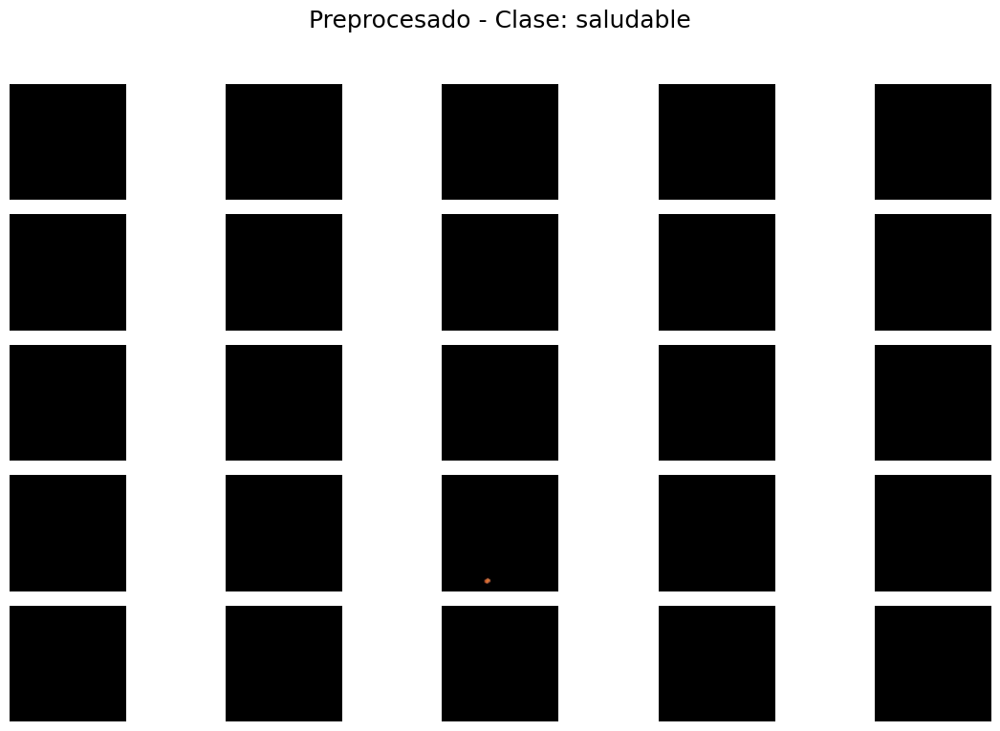

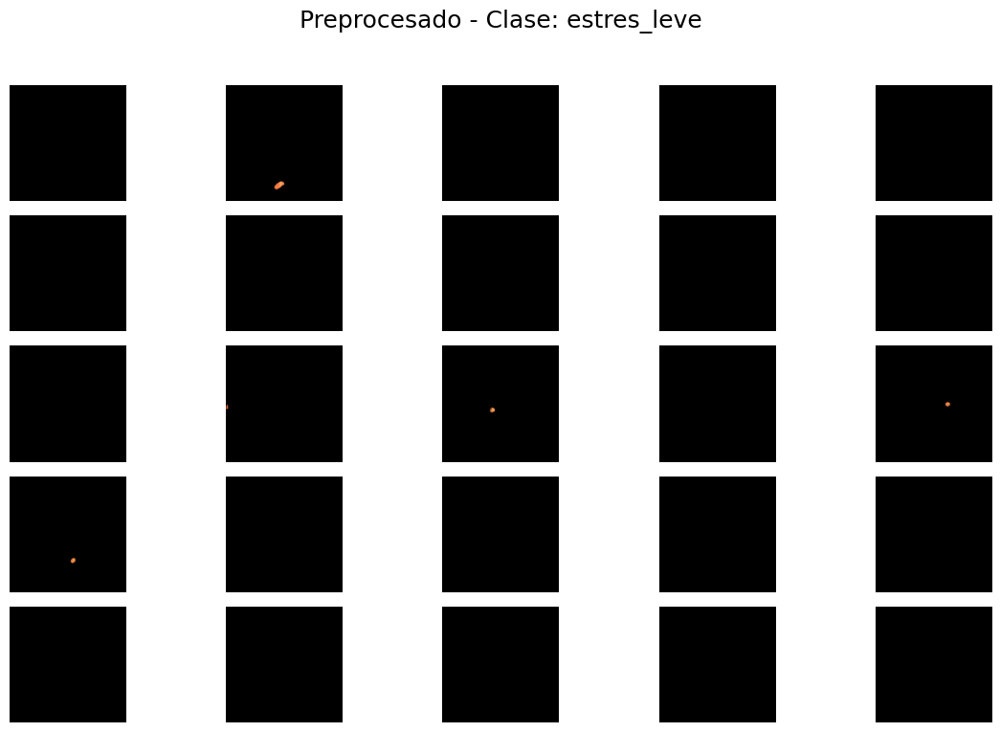

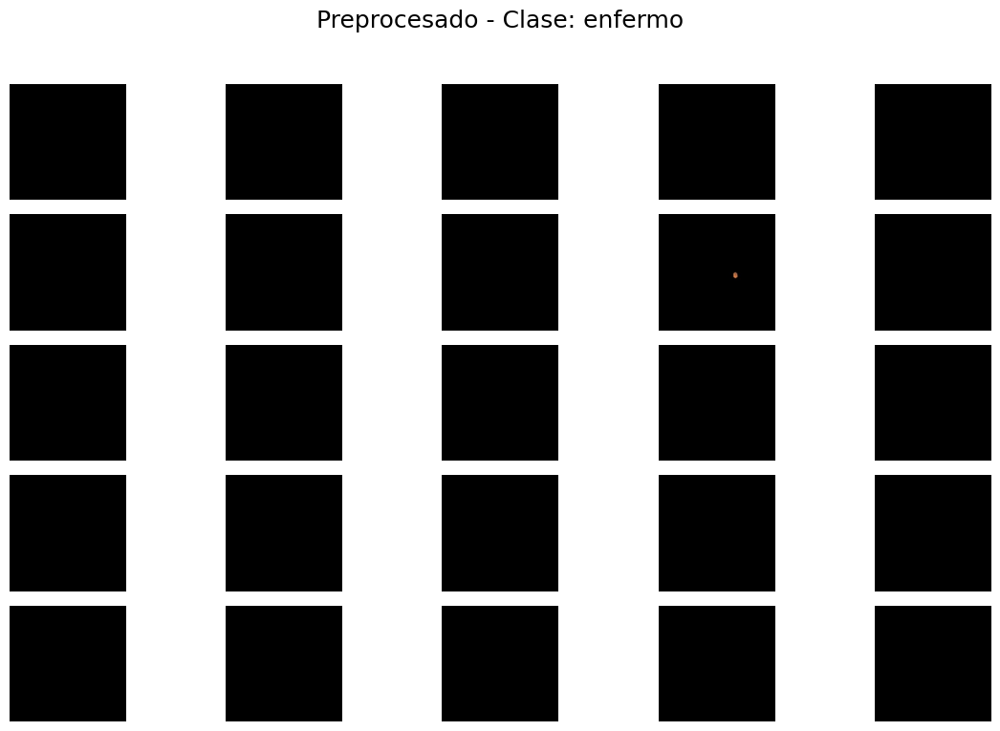

In [3]:
# Configuración: rutas y parámetros
processed_dir = "../data/dataset_procesado"  # Carpeta donde guardaste imágenes preprocesadas
classes = ["saludable", "estres_leve", "enfermo"]
samples_per_class = 25  # Número de imágenes a mostrar por clase

# Mostrar preprocesadas para cada clase
for cls in classes:
    mostrar_preprocesadas_por_clase(cls, processed_dir, samples_per_class)
